In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import plotly.graph_objects as go
import scipy.stats as stats

# P3 - Open Food Facts

In [2]:
#Lecture du csv
data = pd.read_csv('fr.openfoodfacts.org.products.csv', sep='\t', low_memory=False)

## Description des données

In [3]:
row, col = data.shape
print(f'OpenFoodFacts contient {row} lignes et {col} colonnes.')

OpenFoodFacts contient 320772 lignes et 162 colonnes.


In [4]:
data.describe(exclude=[np.number])

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,nutrition_grade_fr,pnns_groups_1,pnns_groups_2,states,states_tags,states_fr,main_category,main_category_fr,image_url,image_small_url
count,320749,320749,320770,320769,320763,320772,320772,303010,52795,104819,...,221210,91513,94491,320726,320726,320726,84366,84366,75836,75836
unique,320749,320749,3535,189567,189568,180495,180495,221347,38584,13826,...,5,14,42,1021,1021,1021,3543,3543,75836,75836
top,0000000003087,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489077120,2017-03-09T10:37:09Z,1439141742,2015-08-09T17:35:42Z,Ice Cream,Pâtes alimentaires au blé dur de qualité supér...,500 g,...,d,unknown,unknown,"en:to-be-completed, en:nutrition-facts-complet...","en:to-be-completed,en:nutrition-facts-complete...","A compléter,Informations nutritionnelles compl...",en:beverages,Boissons,http://fr.openfoodfacts.org/images/products/00...,http://fr.openfoodfacts.org/images/products/00...
freq,1,1,169868,20,20,33,33,410,201,4669,...,62763,22624,22624,168905,168905,168905,6054,6054,1,1


In [5]:
data.describe()

,no_nutriments,additives_n,ingredients_from_palm_oil_n,ingredients_from_palm_oil,ingredients_that_may_be_from_palm_oil_n,ingredients_that_may_be_from_palm_oil,nutrition_grade_uk,energy_100g,energy-from-fat_100g,fat_100g,...,ph_100g,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
count,0.0,248939.000000,248939.000000,0.0,248939.000000,0.0,0.0,2.611130e+05,857.000000,243891.000000,...,49.000000,3036.000000,165.000000,948.000000,0.0,268.000000,221210.000000,221210.000000,0.0,0.0
mean,NaN,1.936024,0.019659,NaN,0.055246,NaN,NaN,1.141915e+03,585.501214,12.730379,...,6.425698,31.458587,15.412121,49.547785,NaN,341.700764,9.165535,9.058049,NaN,NaN
std,NaN,2.502019,0.140524,NaN,0.269207,NaN,NaN,6.447154e+03,712.809943,17.578747,...,2.047841,31.967918,3.753028,18.757932,NaN,425.211439,9.055903,9.183589,NaN,NaN
min,NaN,0.000000,0.000000,NaN,0.000000,NaN,NaN,0.000000e+00,0.000000,0.000000,...,0.000000,0.000000,8.000000,6.000000,NaN,0.000000,-15.000000,-15.000000,NaN,NaN
25%,NaN,0.000000,0.000000,NaN,0.000000,NaN,NaN,3.770000e+02,49.400000,0.000000,...,6.300000,0.000000,12.000000,32.000000,NaN,98.750000,1.000000,1.000000,NaN,NaN
50%,NaN,1.000000,0.000000,NaN,0.000000,NaN,NaN,1.100000e+03,300.000000,5.000000,...,7.200000,23.000000,15.000000,50.000000,NaN,195.750000,10.000000,9.000000,NaN,NaN
75%,NaN,3.000000,0.000000,NaN,0.000000,NaN,NaN,1.674000e+03,898.000000,20.000000,...,7.400000,51.000000,15.000000,64.250000,NaN,383.200000,16.000000,16.000000,NaN,NaN
max,NaN,31.000000,2.000000,NaN,6.000000,NaN,NaN,3.251373e+06,3830.000000,714.290000,...,8.400000,100.000000,25.000000,100.000000,NaN,2842.000000,40.000000,40.000000,NaN,NaN


<Axes: >

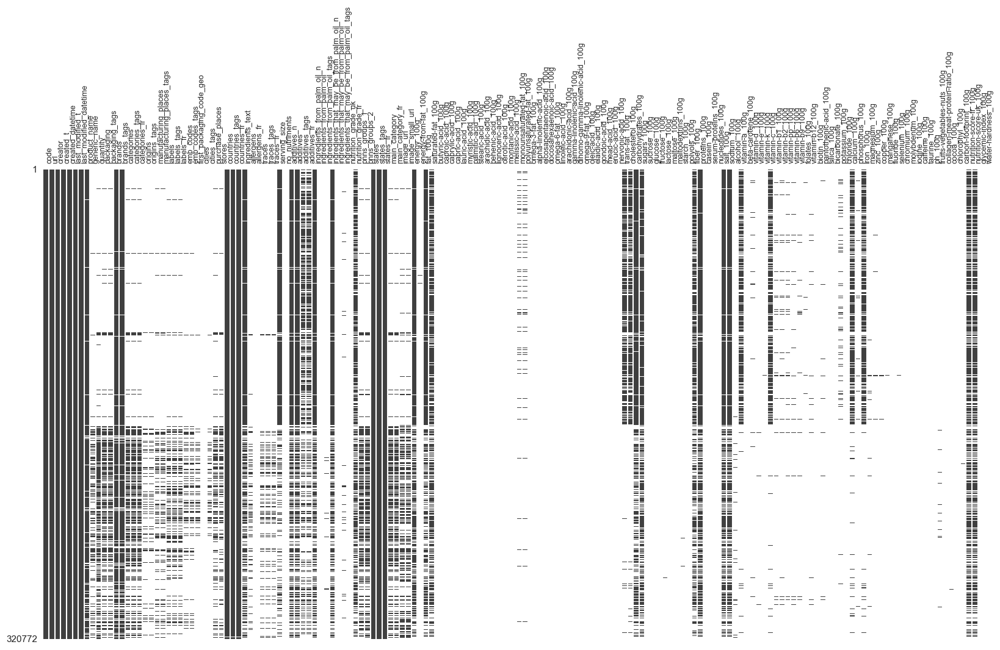

In [6]:
msno.matrix(data, sparkline=False,figsize=(20, 10),fontsize=9, labels=all(data), label_rotation=90)

<Axes: >

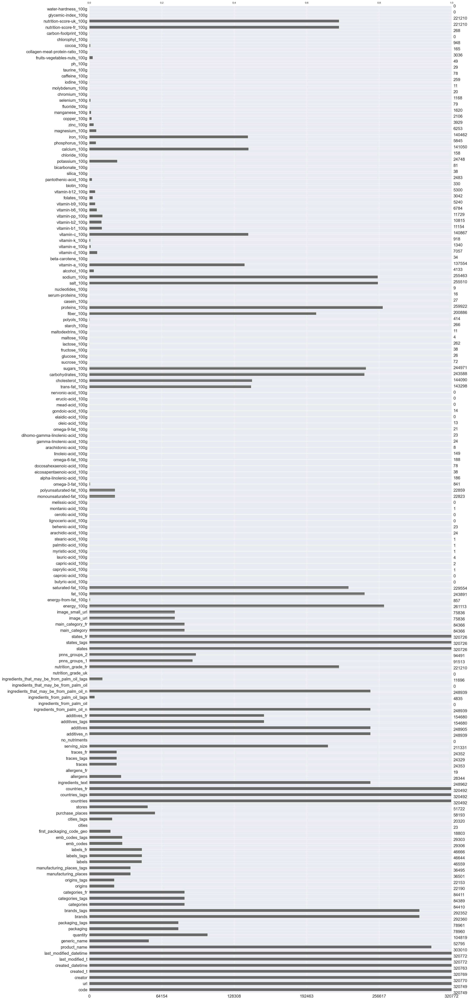

In [7]:
msno.bar(data)

In [8]:
data.isna().mean().mean()

0.7622157263195134

In [9]:
data.head(20)

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,ph_100g,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
0,0000000003087,http://world-fr.openfoodfacts.org/produit/0000...,openfoodfacts-contributors,1474103866,2016-09-17T09:17:46Z,1474103893,2016-09-17T09:18:13Z,Farine de blé noir,NaN,1kg,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0000000004530,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.0,14.0,NaN,NaN
2,0000000004559,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Peanuts,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN
3,0000000016087,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055731,2017-03-09T10:35:31Z,1489055731,2017-03-09T10:35:31Z,Organic Salted Nut Mix,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,12.0,NaN,NaN
4,0000000016094,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055653,2017-03-09T10:34:13Z,1489055653,2017-03-09T10:34:13Z,Organic Polenta,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,0000000016100,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055651,2017-03-09T10:34:11Z,1489055651,2017-03-09T10:34:11Z,Breadshop Honey Gone Nuts Granola,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,0000000016117,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055730,2017-03-09T10:35:30Z,1489055730,2017-03-09T10:35:30Z,Organic Long Grain White Rice,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,0000000016124,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055711,2017-03-09T10:35:11Z,1489055712,2017-03-09T10:35:12Z,Organic Muesli,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,7.0,7.0,NaN,NaN
8,0000000016193,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055651,2017-03-09T10:34:11Z,1489055651,2017-03-09T10:34:11Z,Organic Dark Chocolate Minis,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,0000000016513,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489055654,2017-03-09T10:34:14Z,1489055654,2017-03-09T10:34:14Z,Organic Sunflower Oil,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Nettoyage des données

On supprime les colonnes où plus de 80% des données sont vides

In [10]:
data.drop(data.columns[data.isnull().mean()>0.8], axis=1, inplace=True)

<Axes: >

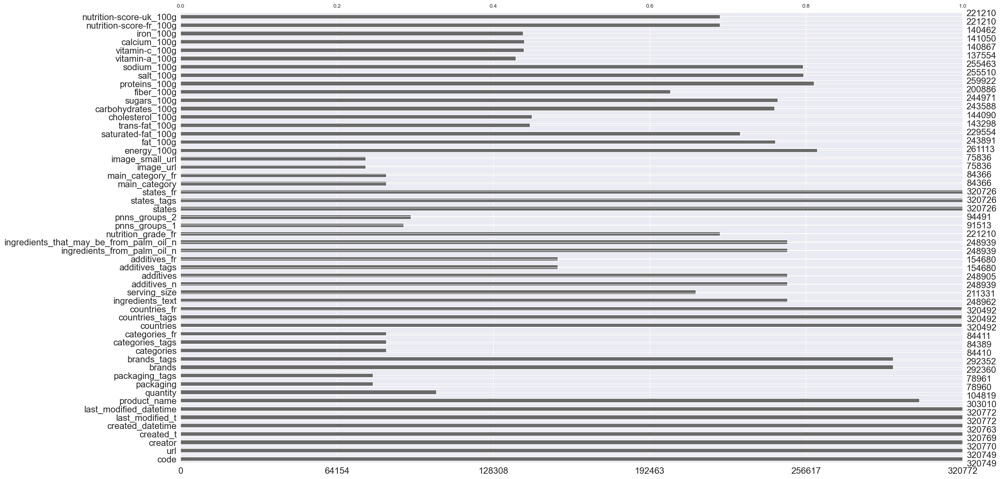

In [11]:
msno.bar(data)

In [12]:
row, col = data.shape
print(f'OpenFoodFacts contient {row} lignes et {col} colonnes.')

OpenFoodFacts contient 320772 lignes et 54 colonnes.


## Exploration

In [13]:
# On récupère seulement les lignes dont la colonne pnns_group_2 est remplie
pnns2 = data[~data['pnns_groups_2'].isna()]

<Axes: >

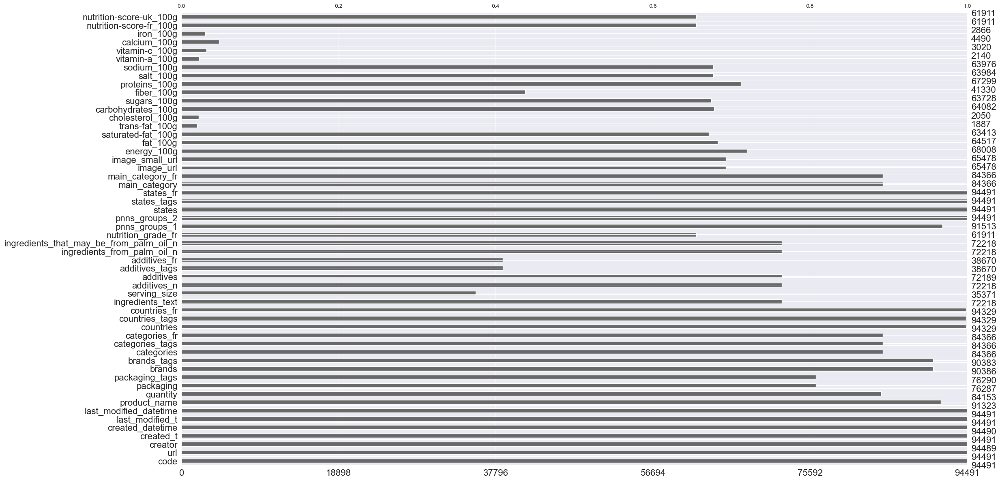

In [14]:
msno.bar(pnns2)

In [15]:
pnns2.isna().mean().mean()

0.27255447020821505

In [16]:
# On supprime les colonnes dont plus de 50% des données sont vides
pnns2.drop(pnns2.columns[pnns2.isnull().mean()>0.5], axis=1, inplace=True)

C:\Users\adrie\AppData\Local\Temp\ipykernel_25844\1241322802.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pnns2.drop(pnns2.columns[pnns2.isnull().mean()>0.5], axis=1, inplace=True)


<Axes: >

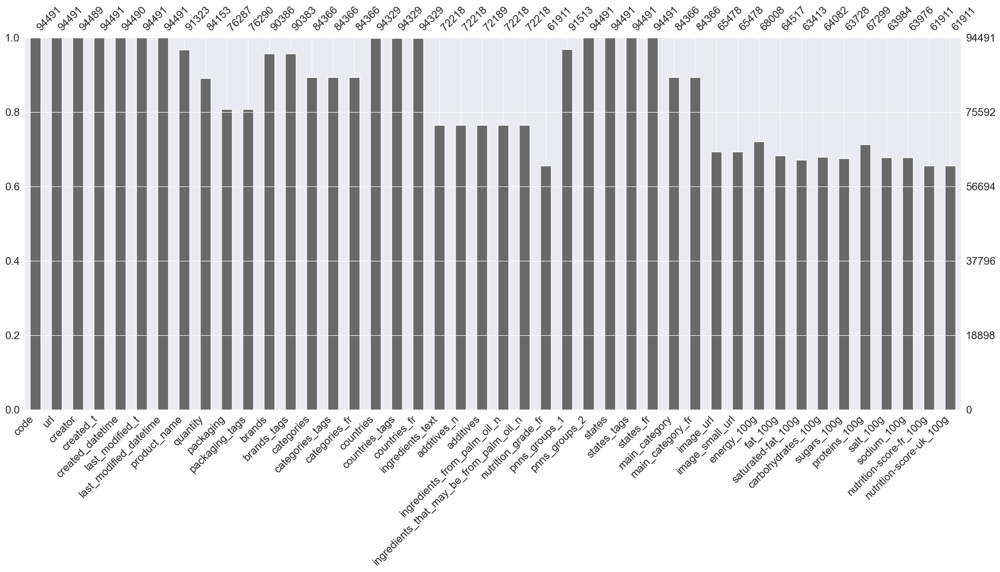

In [17]:
msno.bar(pnns2)

In [18]:
pnns2.isna().mean().mean()

0.14823369421426377

Suppression des colonnes qui ne nous intéresserait pas 
Date de création/modification qui existe plusieurs fois

In [19]:
pnns2 = pnns2.drop(columns=['url','creator','created_t','created_datetime','last_modified_t','last_modified_datetime','quantity','packaging','packaging_tags','brands','brands_tags','categories','categories_tags','categories_fr','countries','countries_tags','countries_fr','additives','additives_n','states','states_fr','states_tags','main_category','image_url','image_small_url','nutrition-score-uk_100g'], axis=1)

<Axes: >

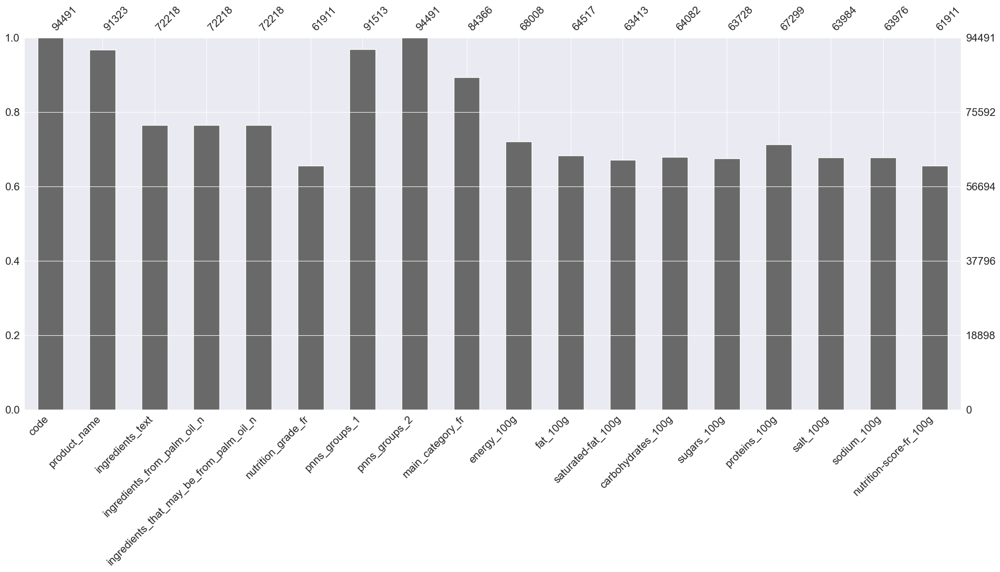

In [20]:
msno.bar(pnns2)

<Axes: >

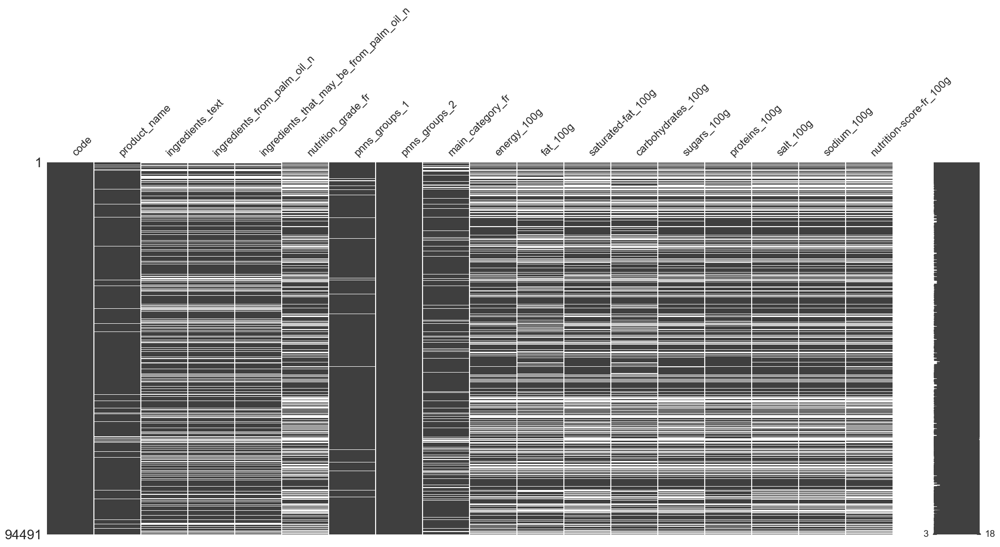

In [21]:
msno.matrix(pnns2)

<Axes: >

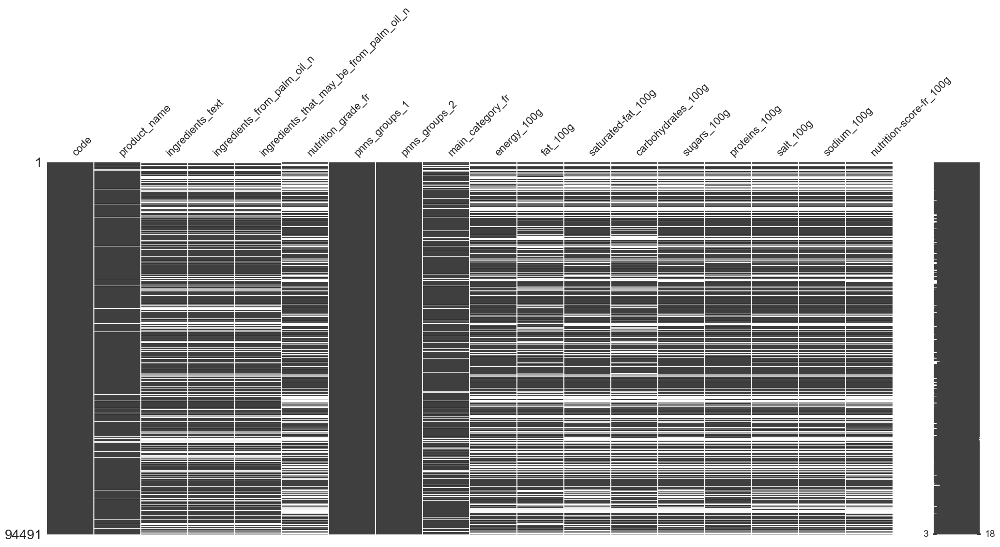

In [22]:
# Corrige les fautes de syntax
pnns2.replace('vegetables','Vegetables',inplace=True)
pnns2.replace('legumes','Vegetables',inplace=True)
pnns2.replace('Legumes','Vegetables',inplace=True)
pnns2.replace('fruits','Fruits',inplace=True)
pnns2.replace('cereals','Cereals',inplace=True)
pnns2.replace('nuts','Nuts',inplace=True)

# Remplir les valeurs manquantes dans 'group' en fonction des valeurs de 'subgroup'
# On suppose qu'il y a une correspondance unique entre 'pnns_groups_2' et 'pnns_groups_1'
pnns2_to_pnns1 = pnns2.groupby('pnns_groups_2')['pnns_groups_1'].agg(lambda x: x.dropna().unique()[0] if len(x.dropna().unique()) > 0 else 'unknown')

# Imputer les valeurs manquantes dans 'pnns_groups_1'
pnns2['pnns_groups_1'] = pnns2.apply(lambda row: pnns2_to_pnns1[row['pnns_groups_2']] if pd.isnull(row['pnns_groups_1']) else row['pnns_groups_1'], axis=1)

msno.matrix(pnns2)

C:\Users\adrie\anaconda3\envs\OpenFoodFact\lib\site-packages\seaborn\axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


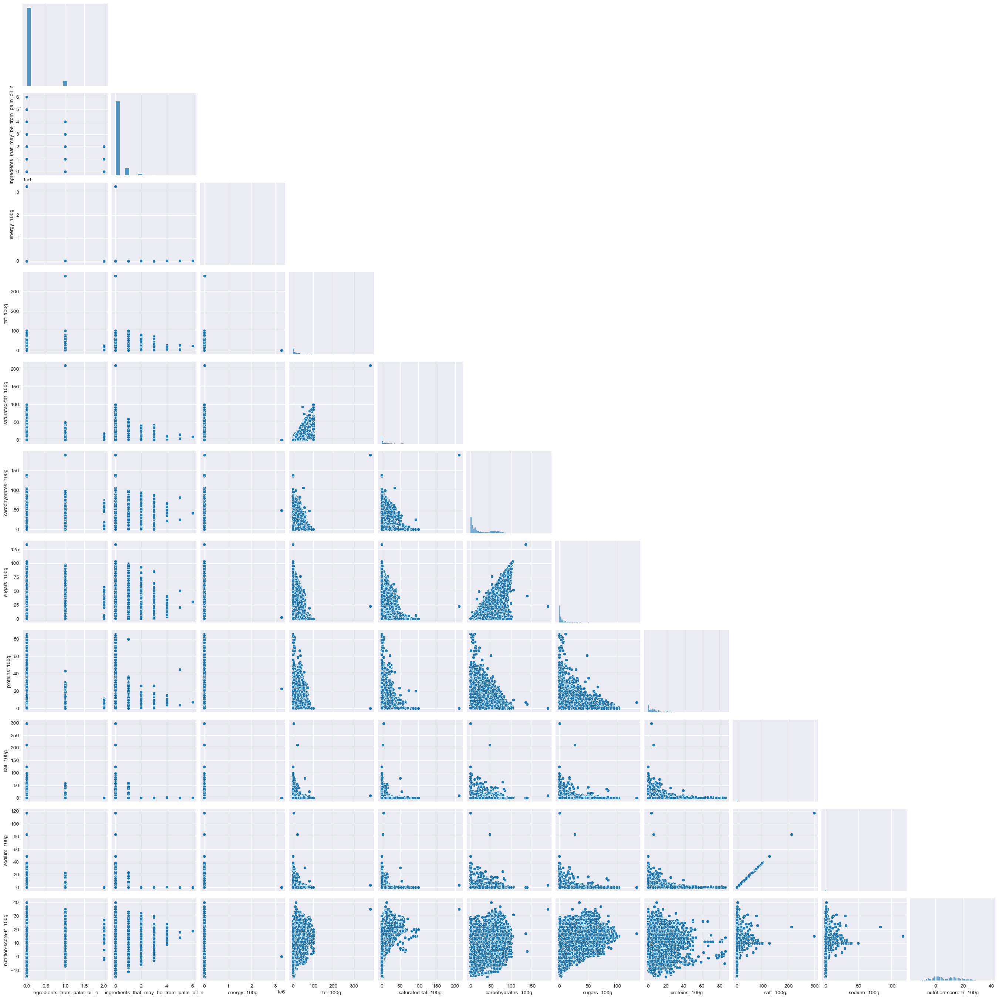

In [23]:
pnns2.dropna(inplace=True)

sns.pairplot(pnns2, corner=True)

In [24]:
# Retire les inconnus dans les groups
pnns2 = pnns2[pnns2['pnns_groups_2'] != 'unknown']
#Des données d'énergie dépassent l'apport calorique maximum, qui est de 900,00 kcal
pnns2 = pnns2.loc[pnns2['energy_100g'] < 900]
#Sélectionne les colonnes avec des entiers
pnns2 = pnns2.drop(['ingredients_from_palm_oil_n','ingredients_that_may_be_from_palm_oil_n','salt_100g'],axis=1)

In [25]:
# On sélectionne les colonnes numériques
numerical_features = pnns2.select_dtypes(include=['float64', 'int64']).columns

# On affiche les colonnes numériques sélectionnées
print(f"Colonnes numériques sélectionnées : {numerical_features}")

x = pnns2[numerical_features]

Colonnes numériques sélectionnées : Index(['energy_100g', 'fat_100g', 'saturated-fat_100g', 'carbohydrates_100g',
       'sugars_100g', 'proteins_100g', 'sodium_100g',
       'nutrition-score-fr_100g'],
      dtype='object')


In [26]:
fig = go.Figure()

fig.add_trace(go.Box(y=pnns2['energy_100g'].values, name=pnns2['energy_100g'].name, boxpoints='all'))

fig.show()

In [27]:
pnns2_without_energy = pnns2.drop(['energy_100g'], axis=1)
fig = go.Figure()
for col in pnns2_without_energy:
    fig.add_trace(go.Box(y=pnns2_without_energy[col].values, name=pnns2_without_energy[col].name,boxpoints="all"))
fig.show()

In [28]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['carbohydrates_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [29]:
# on regroupe les données par pnns_groups_2
grouped = pnns2.groupby('pnns_groups_2')['carbohydrates_100g']

# on extrait les groupes sous forme de listes pour effectuer l'ANOVA
f_stat, p_value = stats.f_oneway(*[group for name, group in grouped])

print(f"F-statistic: {f_stat}")
print(f"P-value: {p_value}")

F-statistic: 880.625324252984
P-value: 0.0


In [30]:
# On regroupe les moyennes des valeurs par groupe
group_means = pnns2.groupby('pnns_groups_2')['carbohydrates_100g'].mean()

# On ajoute les moyennes prédites des groupes
pnns2['predicted_carbohydrates'] = pnns2['pnns_groups_2'].map(group_means)

# On calcule les résidus
pnns2['residuals_carbohydrates'] = pnns2['carbohydrates_100g'] - pnns2['predicted_carbohydrates']

residus = pnns2['residuals_carbohydrates']

# On effectue le test de Kolmogorov-Smirnov
ks_stat, ks_p_value = stats.kstest(residus, 'norm')
print(f"Kolmogorov-Smirnov Test: D={ks_stat}, p-value={ks_p_value}")

Kolmogorov-Smirnov Test: D=0.3550305119697498, p-value=0.0


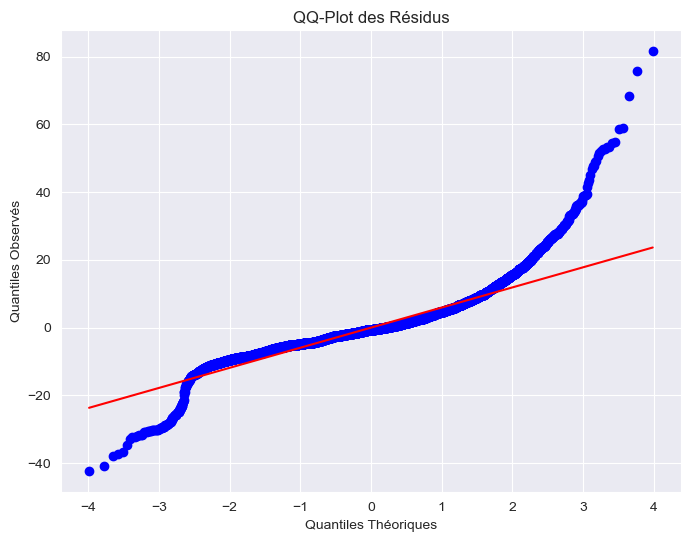

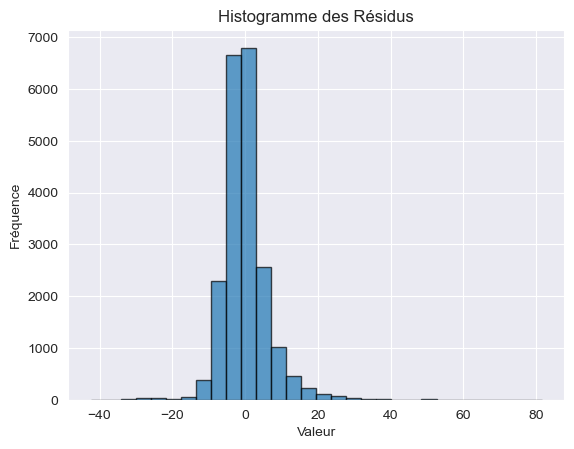

In [31]:
# QQ-plot
plt.figure(figsize=(8, 6))
stats.probplot(residus, dist="norm", plot=plt)
plt.title('QQ-Plot des Résidus')
plt.xlabel('Quantiles Théoriques')
plt.ylabel('Quantiles Observés')
plt.show()

# Histogramme
plt.hist(residus, bins=30, edgecolor='k', alpha=0.7)
plt.title('Histogramme des Résidus')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.show()

In [32]:
# On regroupe les résidus par 'pnns_groups_2'
grouped_residuals = pnns2.groupby('pnns_groups_2')['residuals_carbohydrates'].apply(list)

# On convertit les résidus en liste pour chaque groupe
residus_list = [group for group in grouped_residuals]

# On effectue le test de Levene
stat_levene, p_value_levene = stats.levene(*residus_list)
print(f"Test de Levene: Statistic={stat_levene}, p-value={p_value_levene}")

Test de Levene: Statistic=154.15917181296098, p-value=0.0


In [33]:
# On effectue le test de Kruskal-Wallis
stat_kruskal, p_value_kruskal = stats.kruskal(*residus_list)
print(f"Test de Kruskal-Wallis: Statistic={stat_kruskal}, p-value={p_value_kruskal}")

Test de Kruskal-Wallis: Statistic=540.5178724084612, p-value=4.27569631385411e-93


In [34]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['saturated-fat_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [35]:
# on regroupe les données par pnns_groups_2
grouped = pnns2.groupby('pnns_groups_2')['saturated-fat_100g']

# on extrait les groupes sous forme de listes pour effectuer l'ANOVA
f_stat, p_value = stats.f_oneway(*[group for name, group in grouped])

print(f"F-statistic: {f_stat}")
print(f"P-value: {p_value:.15g}")

F-statistic: 235.5600380308993
P-value: 0


Kolmogorov-Smirnov Test: D=0.21283534002710314, p-value=0.0


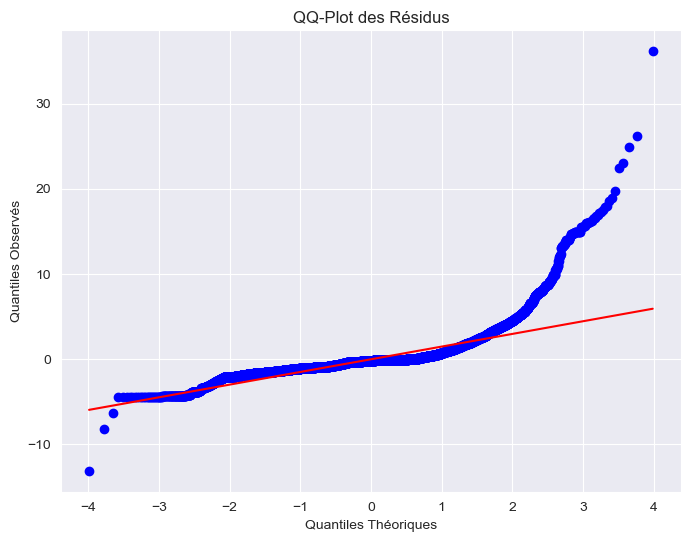

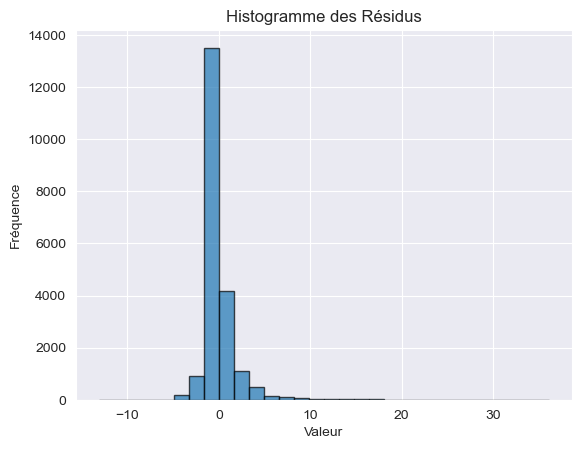

Test de Levene: Statistic=113.41042870657635, p-value=0.0
Test de Kruskal-Wallis: Statistic=1980.2766365412117, p-value=0.0


In [36]:
# On regroupe les moyennes des valeurs par groupe
group_means = pnns2.groupby('pnns_groups_2')['saturated-fat_100g'].mean()

# On ajoute les moyennes prédites des groupes
pnns2['predicted_saturated-fat'] = pnns2['pnns_groups_2'].map(group_means)

# On calcule les résidus
pnns2['residuals_saturated-fat'] = pnns2['saturated-fat_100g'] - pnns2['predicted_saturated-fat']

residus = pnns2['residuals_saturated-fat']

# On effectue le test de Kolmogorov-Smirnov
ks_stat, ks_p_value = stats.kstest(residus, 'norm')
print(f"Kolmogorov-Smirnov Test: D={ks_stat}, p-value={ks_p_value}")

# QQ-plot
plt.figure(figsize=(8, 6))
stats.probplot(residus, dist="norm", plot=plt)
plt.title('QQ-Plot des Résidus')
plt.xlabel('Quantiles Théoriques')
plt.ylabel('Quantiles Observés')
plt.show()

# Histogramme
plt.hist(residus, bins=30, edgecolor='k', alpha=0.7)
plt.title('Histogramme des Résidus')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.show()

# On regroupe les résidus par 'pnns_groups_2'
grouped_residuals = pnns2.groupby('pnns_groups_2')['residuals_saturated-fat'].apply(list)

# On convertit les résidus en liste pour chaque groupe
residus_list = [group for group in grouped_residuals]

# On effectue le test de Levene
stat_levene, p_value_levene = stats.levene(*residus_list)
print(f"Test de Levene: Statistic={stat_levene}, p-value={p_value_levene}")
# On effectue le test de Kruskal-Wallis
stat_kruskal, p_value_kruskal = stats.kruskal(*residus_list)
print(f"Test de Kruskal-Wallis: Statistic={stat_kruskal}, p-value={p_value_kruskal}")

In [37]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['fat_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [38]:
# on regroupe les données par pnns_groups_2
grouped = pnns2.groupby('pnns_groups_2')['fat_100g']

# on extrait les groupes sous forme de listes pour effectuer l'ANOVA
f_stat, p_value = stats.f_oneway(*[group for name, group in grouped])

print(f"F-statistic: {f_stat}")
print(f"P-value: {p_value:.15g}")

F-statistic: 332.43764878742337
P-value: 0


Kolmogorov-Smirnov Test: D=0.23204866796843437, p-value=0.0


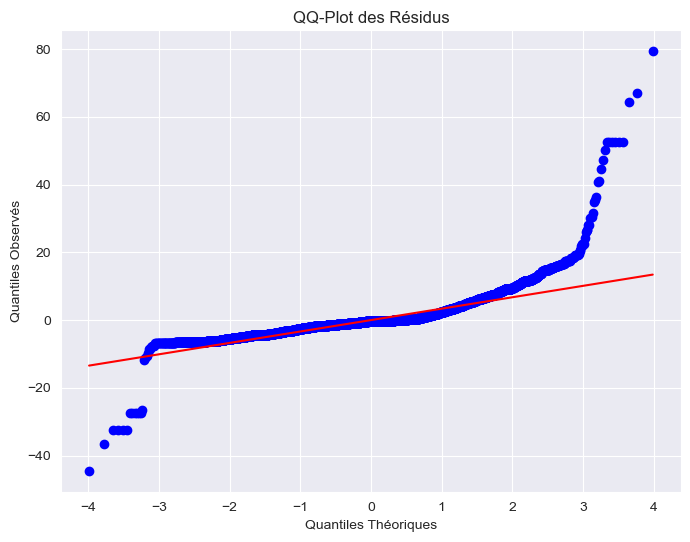

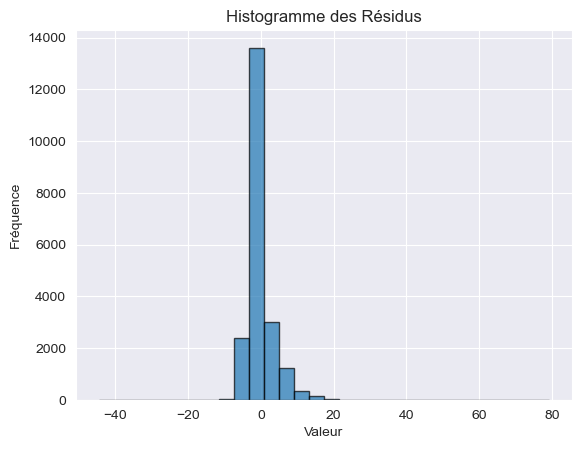

Test de Levene: Statistic=186.78875793327046, p-value=0.0
Test de Kruskal-Wallis: Statistic=1149.3183766389734, p-value=3.1349617908176943e-220


In [39]:
# On regroupe les moyennes des valeurs par groupe
group_means = pnns2.groupby('pnns_groups_2')['fat_100g'].mean()

# On ajoute les moyennes prédites des groupes
pnns2['predicted_fat'] = pnns2['pnns_groups_2'].map(group_means)

# On calcule les résidus
pnns2['residuals_fat'] = pnns2['fat_100g'] - pnns2['predicted_fat']

residus = pnns2['residuals_fat']

# On effectue le test de Kolmogorov-Smirnov
ks_stat, ks_p_value = stats.kstest(residus, 'norm')
print(f"Kolmogorov-Smirnov Test: D={ks_stat}, p-value={ks_p_value}")

# QQ-plot
plt.figure(figsize=(8, 6))
stats.probplot(residus, dist="norm", plot=plt)
plt.title('QQ-Plot des Résidus')
plt.xlabel('Quantiles Théoriques')
plt.ylabel('Quantiles Observés')
plt.show()

# Histogramme
plt.hist(residus, bins=30, edgecolor='k', alpha=0.7)
plt.title('Histogramme des Résidus')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.show()

# On regroupe les résidus par 'pnns_groups_2'
grouped_residuals = pnns2.groupby('pnns_groups_2')['residuals_fat'].apply(list)

# On convertit les résidus en liste pour chaque groupe
residus_list = [group for group in grouped_residuals]

# On effectue le test de Levene
stat_levene, p_value_levene = stats.levene(*residus_list)
print(f"Test de Levene: Statistic={stat_levene}, p-value={p_value_levene}")
# On effectue le test de Kruskal-Wallis
stat_kruskal, p_value_kruskal = stats.kruskal(*residus_list)
print(f"Test de Kruskal-Wallis: Statistic={stat_kruskal}, p-value={p_value_kruskal}")

In [40]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['sugars_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [41]:
# on regroupe les données par pnns_groups_2
grouped = pnns2.groupby('pnns_groups_2')['sugars_100g']

# on extrait les groupes sous forme de listes pour effectuer l'ANOVA
f_stat, p_value = stats.f_oneway(*[group for name, group in grouped])

print(f"F-statistic: {f_stat}")
print(f"P-value: {p_value:.15g}")

F-statistic: 772.0886669770166
P-value: 0


Kolmogorov-Smirnov Test: D=0.22011407470871863, p-value=0.0


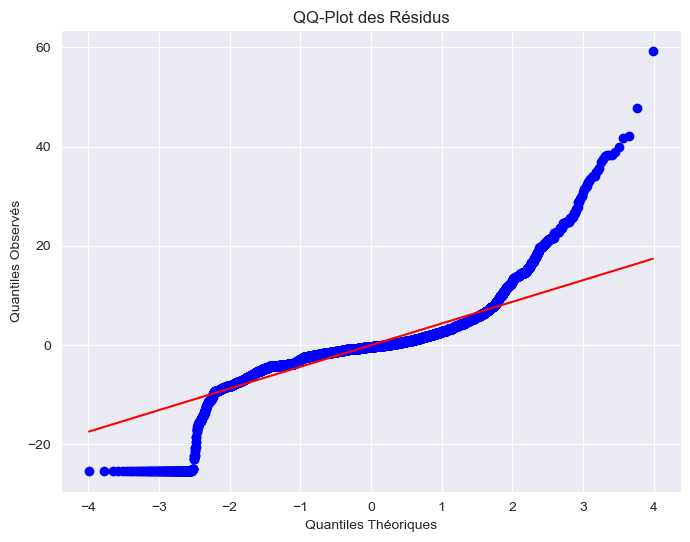

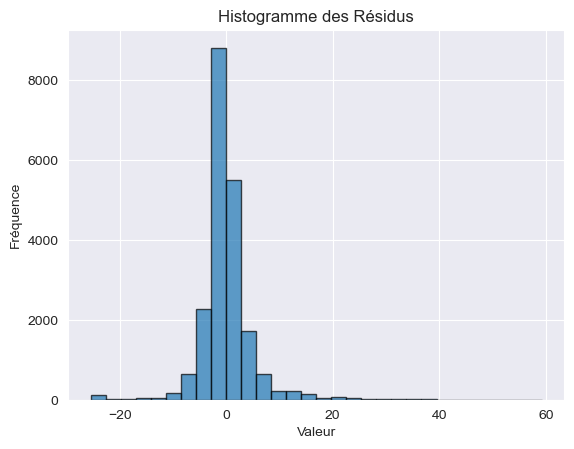

Test de Levene: Statistic=367.05136644278366, p-value=0.0
Test de Kruskal-Wallis: Statistic=742.80566765789, p-value=6.881660051390963e-135


In [42]:
# On regroupe les moyennes des valeurs par groupe
group_means = pnns2.groupby('pnns_groups_2')['sugars_100g'].mean()

# On ajoute les moyennes prédites des groupes
pnns2['predicted_sugars'] = pnns2['pnns_groups_2'].map(group_means)

# On calcule les résidus
pnns2['residuals_sugars'] = pnns2['sugars_100g'] - pnns2['predicted_sugars']

residus = pnns2['residuals_sugars']

# On effectue le test de Kolmogorov-Smirnov
ks_stat, ks_p_value = stats.kstest(residus, 'norm')
print(f"Kolmogorov-Smirnov Test: D={ks_stat}, p-value={ks_p_value}")

# QQ-plot
plt.figure(figsize=(8, 6))
stats.probplot(residus, dist="norm", plot=plt)
plt.title('QQ-Plot des Résidus')
plt.xlabel('Quantiles Théoriques')
plt.ylabel('Quantiles Observés')
plt.show()

# Histogramme
plt.hist(residus, bins=30, edgecolor='k', alpha=0.7)
plt.title('Histogramme des Résidus')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.show()

# On regroupe les résidus par 'pnns_groups_2'
grouped_residuals = pnns2.groupby('pnns_groups_2')['residuals_sugars'].apply(list)

# On convertit les résidus en liste pour chaque groupe
residus_list = [group for group in grouped_residuals]

# On effectue le test de Levene
stat_levene, p_value_levene = stats.levene(*residus_list)
print(f"Test de Levene: Statistic={stat_levene}, p-value={p_value_levene}")
# On effectue le test de Kruskal-Wallis
stat_kruskal, p_value_kruskal = stats.kruskal(*residus_list)
print(f"Test de Kruskal-Wallis: Statistic={stat_kruskal}, p-value={p_value_kruskal}")

In [43]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['proteins_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [44]:
# on regroupe les données par pnns_groups_2
grouped = pnns2.groupby('pnns_groups_2')['proteins_100g']

# on extrait les groupes sous forme de listes pour effectuer l'ANOVA
f_stat, p_value = stats.f_oneway(*[group for name, group in grouped])

print(f"F-statistic: {f_stat}")
print(f"P-value: {p_value:.15g}")

F-statistic: 2133.2905872113834
P-value: 0


Kolmogorov-Smirnov Test: D=0.13361693905464844, p-value=0.0


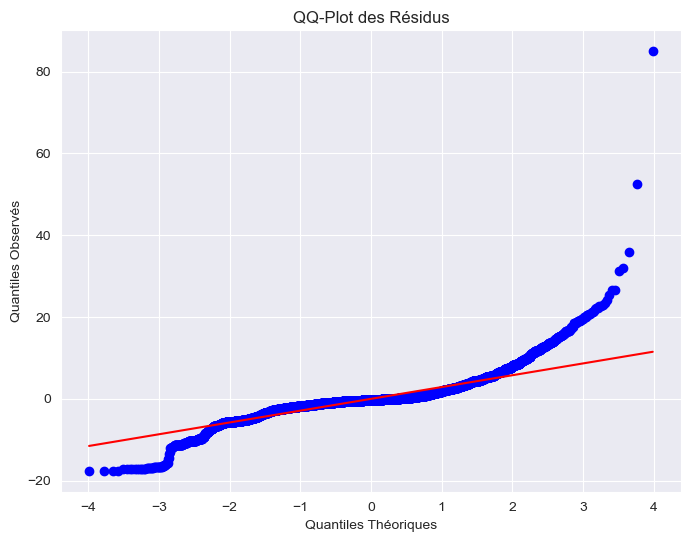

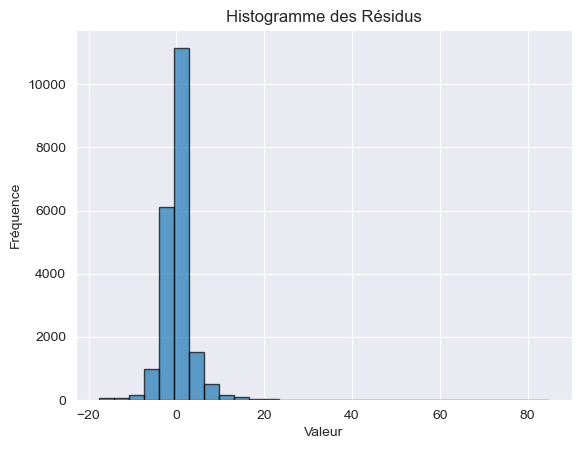

Test de Levene: Statistic=180.45502683236114, p-value=0.0
Test de Kruskal-Wallis: Statistic=908.9708780562878, p-value=1.2909492832756687e-169


In [45]:
# On regroupe les moyennes des valeurs par groupe
group_means = pnns2.groupby('pnns_groups_2')['proteins_100g'].mean()

# On ajoute les moyennes prédites des groupes
pnns2['predicted_proteins'] = pnns2['pnns_groups_2'].map(group_means)

# On calcule les résidus
pnns2['residuals_proteins'] = pnns2['proteins_100g'] - pnns2['predicted_proteins']

residus = pnns2['residuals_proteins']

# On effectue le test de Kolmogorov-Smirnov
ks_stat, ks_p_value = stats.kstest(residus, 'norm')
print(f"Kolmogorov-Smirnov Test: D={ks_stat}, p-value={ks_p_value}")

# QQ-plot
plt.figure(figsize=(8, 6))
stats.probplot(residus, dist="norm", plot=plt)
plt.title('QQ-Plot des Résidus')
plt.xlabel('Quantiles Théoriques')
plt.ylabel('Quantiles Observés')
plt.show()

# Histogramme
plt.hist(residus, bins=30, edgecolor='k', alpha=0.7)
plt.title('Histogramme des Résidus')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.show()

# On regroupe les résidus par 'pnns_groups_2'
grouped_residuals = pnns2.groupby('pnns_groups_2')['residuals_proteins'].apply(list)

# On convertit les résidus en liste pour chaque groupe
residus_list = [group for group in grouped_residuals]

# On effectue le test de Levene
stat_levene, p_value_levene = stats.levene(*residus_list)
print(f"Test de Levene: Statistic={stat_levene}, p-value={p_value_levene}")
# On effectue le test de Kruskal-Wallis
stat_kruskal, p_value_kruskal = stats.kruskal(*residus_list)
print(f"Test de Kruskal-Wallis: Statistic={stat_kruskal}, p-value={p_value_kruskal}")

In [46]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['sodium_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [47]:
# on regroupe les données par pnns_groups_2
grouped = pnns2.groupby('pnns_groups_2')['sodium_100g']

# on extrait les groupes sous forme de listes pour effectuer l'ANOVA
f_stat, p_value = stats.f_oneway(*[group for name, group in grouped])

print(f"F-statistic: {f_stat}")
print(f"P-value: {p_value:.15g}")

F-statistic: 59.813717214101764
P-value: 0


Kolmogorov-Smirnov Test: D=0.3488849153574911, p-value=0.0


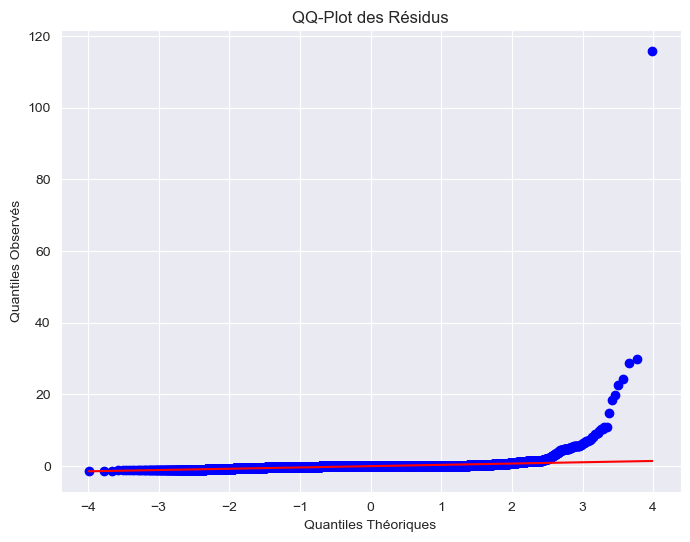

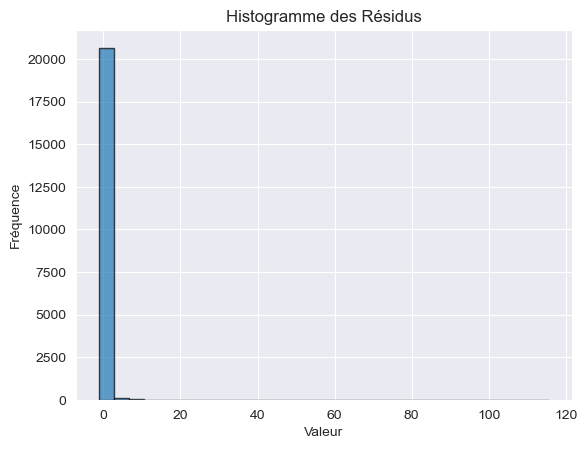

Test de Levene: Statistic=24.583265520730162, p-value=4.71176499815833e-146
Test de Kruskal-Wallis: Statistic=3021.8583032759398, p-value=0.0


In [48]:
# On regroupe les moyennes des valeurs par groupe
group_means = pnns2.groupby('pnns_groups_2')['sodium_100g'].mean()

# On ajoute les moyennes prédites des groupes
pnns2['predicted_sodium'] = pnns2['pnns_groups_2'].map(group_means)

# On calcule les résidus
pnns2['residuals_sodium'] = pnns2['sodium_100g'] - pnns2['predicted_sodium']

residus = pnns2['residuals_sodium']

# On effectue le test de Kolmogorov-Smirnov
ks_stat, ks_p_value = stats.kstest(residus, 'norm')
print(f"Kolmogorov-Smirnov Test: D={ks_stat}, p-value={ks_p_value}")

# QQ-plot
plt.figure(figsize=(8, 6))
stats.probplot(residus, dist="norm", plot=plt)
plt.title('QQ-Plot des Résidus')
plt.xlabel('Quantiles Théoriques')
plt.ylabel('Quantiles Observés')
plt.show()

# Histogramme
plt.hist(residus, bins=30, edgecolor='k', alpha=0.7)
plt.title('Histogramme des Résidus')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.show()

# On regroupe les résidus par 'pnns_groups_2'
grouped_residuals = pnns2.groupby('pnns_groups_2')['residuals_sodium'].apply(list)

# On convertit les résidus en liste pour chaque groupe
residus_list = [group for group in grouped_residuals]

# On effectue le test de Levene
stat_levene, p_value_levene = stats.levene(*residus_list)
print(f"Test de Levene: Statistic={stat_levene}, p-value={p_value_levene}")
# On effectue le test de Kruskal-Wallis
stat_kruskal, p_value_kruskal = stats.kruskal(*residus_list)
print(f"Test de Kruskal-Wallis: Statistic={stat_kruskal}, p-value={p_value_kruskal}")

In [49]:
fig = go.Figure()
fig.add_trace(go.Box(y=pnns2['nutrition-score-fr_100g'].values,x=pnns2['pnns_groups_2'],boxpoints="all"))
fig.show()

In [50]:
# on regroupe les données par pnns_groups_2
grouped = pnns2.groupby('pnns_groups_2')['nutrition-score-fr_100g']

# on extrait les groupes sous forme de listes pour effectuer l'ANOVA
f_stat, p_value = stats.f_oneway(*[group for name, group in grouped])

print(f"F-statistic: {f_stat}")
print(f"P-value: {p_value:.15g}")

F-statistic: 591.2141199150587
P-value: 0


Kolmogorov-Smirnov Test: D=0.3180538690442741, p-value=0.0


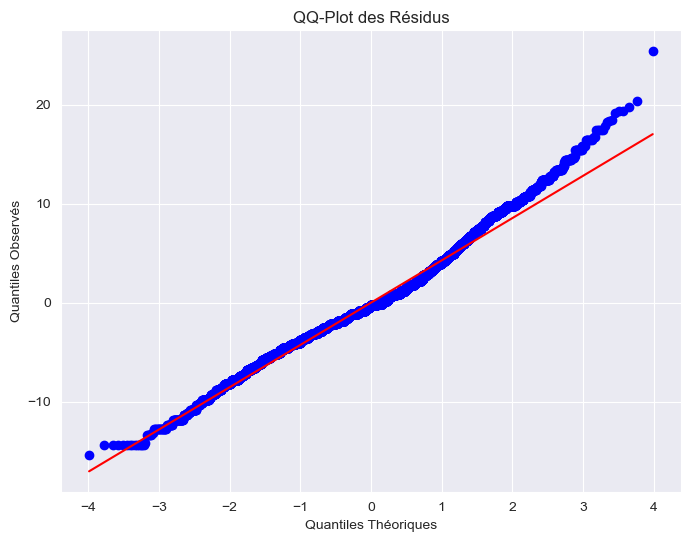

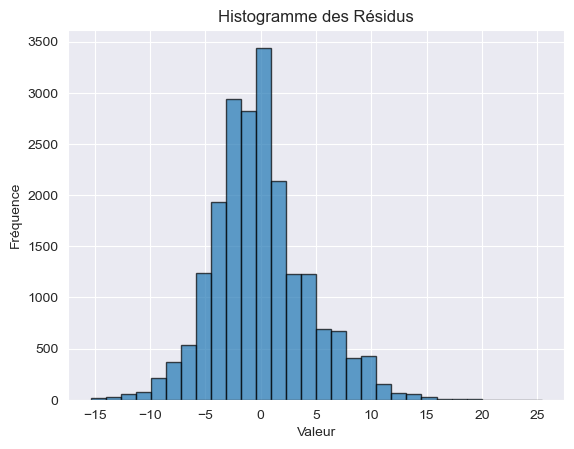

Test de Levene: Statistic=78.81222280879621, p-value=0.0
Test de Kruskal-Wallis: Statistic=266.6583096998775, p-value=2.3455938014006718e-38


In [51]:
# On regroupe les moyennes des valeurs par groupe
group_means = pnns2.groupby('pnns_groups_2')['nutrition-score-fr_100g'].mean()

# On ajoute les moyennes prédites des groupes
pnns2['predicted_nutrition-score-fr'] = pnns2['pnns_groups_2'].map(group_means)

# On calcule les résidus
pnns2['residuals_nutrition-score-fr'] = pnns2['nutrition-score-fr_100g'] - pnns2['predicted_nutrition-score-fr']

residus = pnns2['residuals_nutrition-score-fr']

# On effectue le test de Kolmogorov-Smirnov
ks_stat, ks_p_value = stats.kstest(residus, 'norm')
print(f"Kolmogorov-Smirnov Test: D={ks_stat}, p-value={ks_p_value}")

# QQ-plot
plt.figure(figsize=(8, 6))
stats.probplot(residus, dist="norm", plot=plt)
plt.title('QQ-Plot des Résidus')
plt.xlabel('Quantiles Théoriques')
plt.ylabel('Quantiles Observés')
plt.show()

# Histogramme
plt.hist(residus, bins=30, edgecolor='k', alpha=0.7)
plt.title('Histogramme des Résidus')
plt.xlabel('Valeur')
plt.ylabel('Fréquence')
plt.show()

# On regroupe les résidus par 'pnns_groups_2'
grouped_residuals = pnns2.groupby('pnns_groups_2')['residuals_nutrition-score-fr'].apply(list)

# On convertit les résidus en liste pour chaque groupe
residus_list = [group for group in grouped_residuals]

# On effectue le test de Levene
stat_levene, p_value_levene = stats.levene(*residus_list)
print(f"Test de Levene: Statistic={stat_levene}, p-value={p_value_levene}")
# On effectue le test de Kruskal-Wallis
stat_kruskal, p_value_kruskal = stats.kruskal(*residus_list)
print(f"Test de Kruskal-Wallis: Statistic={stat_kruskal}, p-value={p_value_kruskal}")

On réduit le nombre de groupes, en les rassemblant dans des catégories plus générales

In [52]:
pnns2.replace('Dairy desserts','Milk',inplace=True)
pnns2.replace('Ice cream','Milk',inplace=True)
pnns2.replace('Milk and yogurt','Milk',inplace=True)
pnns2.replace('Breakfast cereals','Cereals',inplace=True)
pnns2.replace('Bread','Cereals',inplace=True)
pnns2.replace('Fruit juices','Fruits',inplace=True)
pnns2.replace('Fruit nectars','Fruits',inplace=True)
pnns2.replace('Processed meat','Proteins',inplace=True)
pnns2.replace('Meat','Proteins',inplace=True)
pnns2.replace('Fish and seafood','Proteins',inplace=True)
pnns2.replace('Eggs','Proteins',inplace=True)
pnns2.replace('Cheese','Proteins',inplace=True)
pnns2.replace('One-dish meals','Meals',inplace=True)
pnns2.replace('Pizza pies and quiche','Meals',inplace=True)
pnns2.replace('Sandwich','Meals',inplace=True)
pnns2.replace('Soups','Vegetables',inplace=True)
pnns2.replace('Chocolate products','Sweets',inplace=True)
pnns2.replace('Dried fruits','Sweets',inplace=True)
pnns2.replace('Nuts','Others',inplace=True)
pnns2.replace('pastries','Others',inplace=True)
pnns2.replace('Fats','Others',inplace=True)
pnns2.replace('Appetizers','Others',inplace=True)
pnns2.replace('Biscuits and cakes','Others',inplace=True)
pnns2.replace('Potatoes','Others',inplace=True)


In [53]:
pnns2['pnns_groups_2'].value_counts()

pnns_groups_2
Meals                               3800
Proteins                            3453
Milk                                2925
Vegetables                          2700
Fruits                              2380
Dressings and sauces                1431
Sweetened beverages                 1279
Non-sugared beverages               1198
Cereals                              569
Sweets                               563
Artificially sweetened beverages     216
Others                               194
Alcoholic beverages                   31
Tripe dishes                          30
Name: count, dtype: int64

In [54]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

scaler = StandardScaler()
scaler.fit(x)
x_standardized = scaler.transform(x)

x_standardized_df = pd.DataFrame(x_standardized, columns=numerical_features)

# On crée un objet PCA
pca = PCA()

# On ajuste et transforme les données
principal_components = pca.fit_transform(x_standardized_df)

# On crée un df avec les composantes principales
pca_df = pd.DataFrame(principal_components, columns=[f'PC{i+1}' for i in range(pca.n_components_)])

Variance expliquée par chaque composante : [0.34171623 0.24406567 0.13200485 0.11354789 0.08640542 0.04259811
 0.02815325 0.01150859]
Variance expliquée cumulée : [0.34171623 0.5857819  0.71778674 0.83133463 0.91774005 0.96033816
 0.98849141 1.        ]


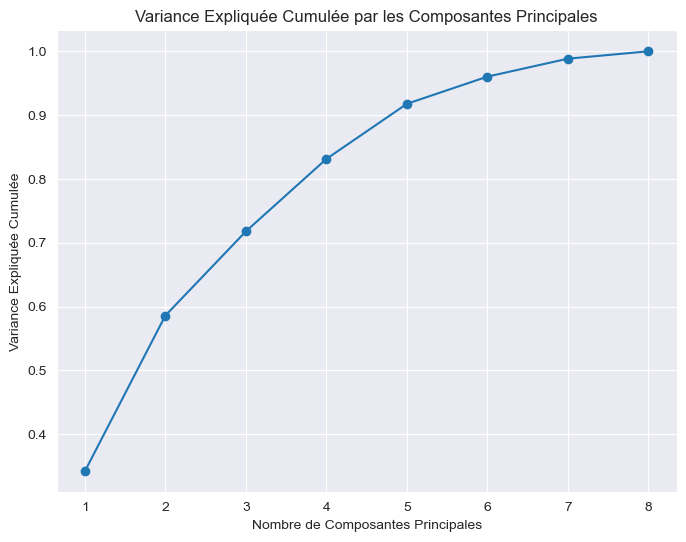

In [55]:
import matplotlib.pyplot as plt
import numpy as np

# Variance expliquée par chaque composante principale
explained_variance = pca.explained_variance_ratio_
print(f"Variance expliquée par chaque composante : {explained_variance}")

# Somme cumulée de la variance expliquée
cumulative_explained_variance = np.cumsum(explained_variance)
print(f"Variance expliquée cumulée : {cumulative_explained_variance}")

# Graphe de la variance expliquée
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(explained_variance) + 1), cumulative_explained_variance, marker='o')
plt.title('Variance Expliquée Cumulée par les Composantes Principales')
plt.xlabel('Nombre de Composantes Principales')
plt.ylabel('Variance Expliquée Cumulée')
plt.grid(True)
plt.show()


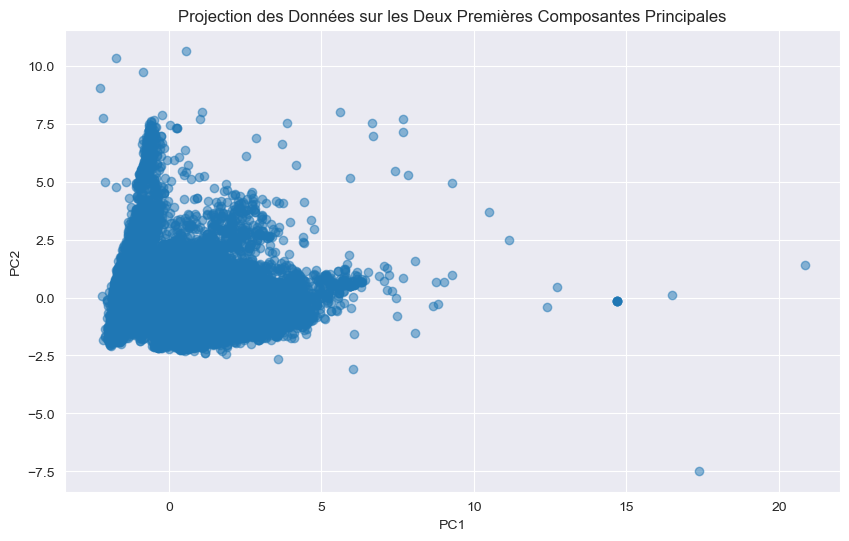

In [56]:
plt.figure(figsize=(10, 6))
plt.scatter(pca_df['PC1'], pca_df['PC2'], alpha=0.5)
plt.title('Projection des Données sur les Deux Premières Composantes Principales')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.grid(True)
plt.show()

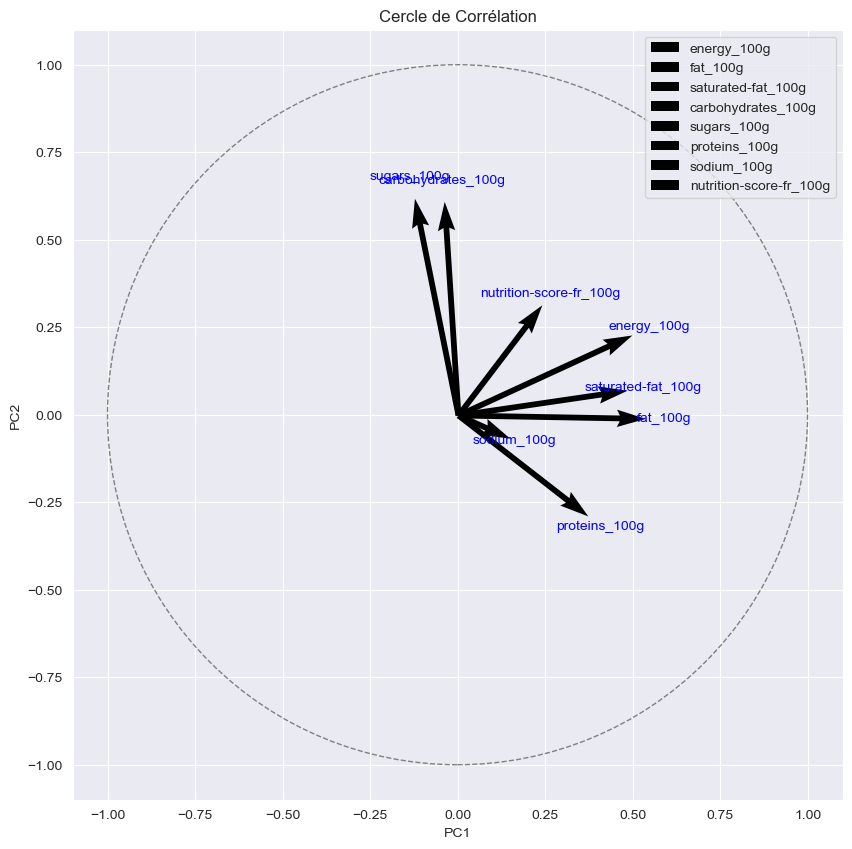

In [57]:
# On obtient les composantes principales et la matrice de chargements
components = pca.components_
explained_variance = pca.explained_variance_ratio_

# on crée le cercle de corrélation
fig, ax = plt.subplots(figsize=(10, 10))
circle = plt.Circle((0, 0), 1, color='gray', fill=False, linestyle='--')

# On ajoute le cercle au graphique
ax.add_artist(circle)

# On ajoute les vecteurs des variables
for i, (var, comp) in enumerate(zip(numerical_features, components.T)):
    ax.quiver(0, 0, comp[0], comp[1], angles='xy', scale_units='xy', scale=1, label=var)
    ax.text(comp[0]*1.1, comp[1]*1.1, var, color='blue', ha='center', va='center')

# On configure les axes
ax.set_xlim(-1.1, 1.1)
ax.set_ylim(-1.1, 1.1)
ax.set_aspect('equal')
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_title('Cercle de Corrélation')
ax.legend(loc='upper right')

# On affiche le graphe
plt.grid(True)
plt.show()


In [58]:
from sklearn.manifold import TSNE

print('Instantiation...')
tsne = TSNE(perplexity=5,metric='euclidean', init='pca')

# fit transform les données
print('Fit_Transforme les données...')
x_tsne = tsne.fit_transform(x)


Instantiation...
Fit_Transforme les données...


Scatter


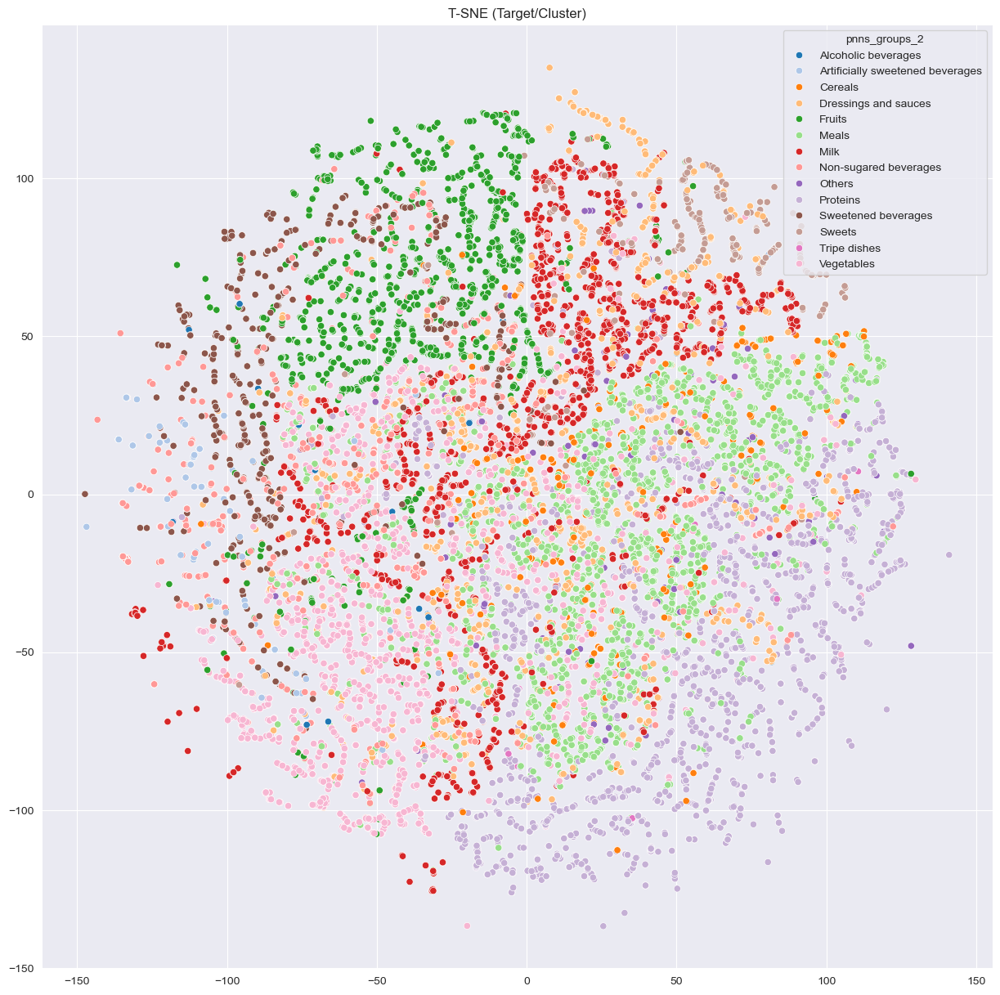

In [59]:
from sklearn.preprocessing import LabelEncoder

# encode les noms de groupes pour les associer à une couleur
le = LabelEncoder()
le.fit(pnns2['pnns_groups_2'])
encoder = le.transform(pnns2['pnns_groups_2'])
encoder.reshape(20769)

# taille du graphique
taille = 15

fig, ax = plt.subplots(1, 1, figsize=(taille, taille))

print('Scatter')
sns.scatterplot(x=tsne.embedding_[:,0],y=tsne.embedding_[:,1], hue=pnns2['pnns_groups_2'], palette='tab20',hue_order=le.classes_,)
ax.set_title('T-SNE (Target/Cluster)')
sns.set_theme(style='dark')

plt.show()